In [1]:
from sklearn.datasets import make_classification
import numpy as np
X, y = make_classification(n_samples=100, n_features=2, n_informative=1, n_redundant=0, n_classes=2,
                           n_clusters_per_class=1, random_state=41, hypercube=False, class_sep=10)

In [2]:
import matplotlib.pyplot as plt

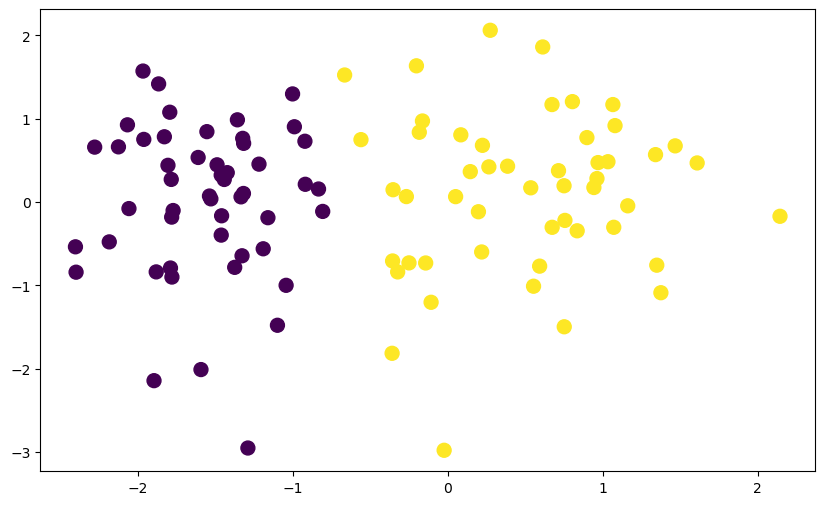

In [3]:
plt.figure(figsize=(10,6))
plt.scatter(X[:,0], X[:, 1],c=y,s=100)
plt.show()

In [4]:
from sklearn.model_selection import train_test_split as tts
X_train, X_test, y_train, y_test = tts(X, y, test_size=0.2, random_state=39)

In [5]:
from sklearn.linear_model import Perceptron
clf = Perceptron(alpha=0.01)
clf.fit(X_train, y_train)

Perceptron(alpha=0.01)

In [6]:
from sklearn.metrics import accuracy_score
y_pred = clf.predict(X_test)
accuracy_score(y_test, y_pred)

1.0

In [7]:
clf.coef_

array([[4.77110113, 0.58775741]])

In [8]:
clf.intercept_

array([3.])

In [46]:
def pos_or_neg(z):
    return 1 if z > 0 else 0

class MyPerceptron:
    def __init__(self, epoch=1000, learning_rate=0.01):
        self.coef_ = None
        self.intercept_ = None
        self.epoch = epoch
        self.learning_rate = learning_rate
        
    def fit(self, X_train, y_train):
        X_train = np.insert(X_train,0,1,axis=1)   
        omegas = np.ones(X_train.shape[1])       

        m_hist = []
        b_hist = []

        for i in range(self.epoch):
            idx = np.random.randint(0, X_train.shape[0])
            y_hat = pos_or_neg(np.dot(X_train[idx], omegas))
            omegas = omegas + self.learning_rate * (y_train[idx] - y_hat) * X_train[idx]

          
            coef_ = omegas[1:]
            intercept_ = omegas[0]
            if coef_[1] != 0:   
                m_hist.append(-(coef_[0]/coef_[1]))
                b_hist.append(-(intercept_/coef_[1]))


        self.intercept_ = omegas[0]
        self.coef_ = omegas[1:]
        return m_hist, b_hist

    def predict(self, X_test):
        X_test = np.insert(X_test, 0, 1, axis=1)
        return np.array([pos_or_neg(np.dot(x, np.insert(self.coef_, 0, self.intercept_))) 
                         for x in X_test])

In [47]:
clf = MyPerceptron()
m, b = clf.fit(X_train, y_train)

In [48]:
intercept_ = clf.intercept_
intercept_

np.float64(0.8799999999999999)

In [49]:
coef_ = clf.coef_
coef_

array([1.33724725, 0.28145763])

In [50]:
y_pred = clf.predict(X_test)

In [51]:
accuracy_score(y_test, y_pred)

0.95

In [52]:
x_input = np.linspace(-3,3,100)
y_input = m[-1]*x_input + b[-1]

(-3.0, 2.0)

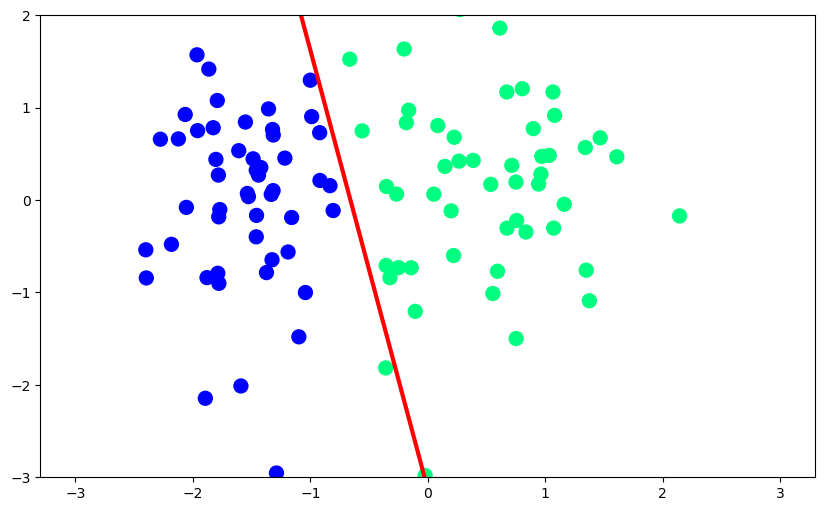

In [53]:
plt.figure(figsize=(10,6))
plt.plot(x_input,y_input,color='red',linewidth=3)
plt.scatter(X[:,0],X[:,1],c=y,cmap='winter',s=100)
plt.ylim(-3,2)

In [56]:
%matplotlib inline
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

fig, ax = plt.subplots(figsize=(9,5))

x_i = np.arange(-3, 3, 0.1)
y_i = x_i*m[0] + b[0]
ax.scatter(X[:,0], X[:,1], c=y, cmap='winter', s=100)
line, = ax.plot(x_i, y_i, 'r-', linewidth=2)
plt.ylim(-3,3)

def update(i):
    label = f'epoch {i+1}'
    line.set_ydata(x_i*m[i] + b[i])
    ax.set_xlabel(label)
    return line,

anim = FuncAnimation(fig, update, frames=len(m), interval=100, repeat=True)

HTML(anim.to_jshtml())  # <-- render animation as HTML/JS


Animation size has reached 20999193 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [58]:
from sklearn.linear_model import LogisticRegression
lor = LogisticRegression()
lor.fit(X_train,y_train)

LogisticRegression()

In [59]:
y_pred = lor.predict(X_test)
accuracy_score(y_test, y_pred)

1.0

In [62]:
lor.coef_

array([[3.25734912, 0.10648028]])

In [63]:
m = -(lor.coef_[0][0]/lor.coef_[0][1])
b = -(lor.intercept_[0]/lor.coef_[0][1])

In [64]:
x_input1 = np.linspace(-3,3,100)
y_input1 = m*x_input + b

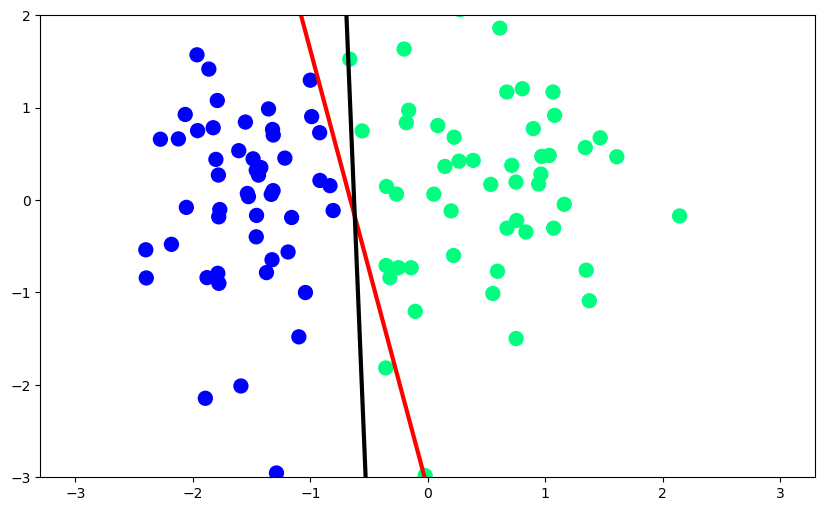

In [72]:
plt.figure(figsize=(10,6))
plt.scatter(X[:,0],X[:,1],c=y,cmap='winter',s=100)
plt.plot(x_input,y_input,color='red',linewidth=3)
plt.plot(x_input1,y_input1,color='black',linewidth=3)
plt.ylim(-3,2)
plt.show()